In [2]:
import import_all
# dataframes are rent, evict, and police
from altair import *

pd=import_all.pd

In [5]:
evict = import_all.evict
police = import_all.police

evict_reasons = pd.read_csv('/data/leils/evict_with_reasons.csv')

# Evictions EDA
---
## Overall Evictions

In [3]:
list(evict)

['Address',
 'NonPayment',
 'Breach',
 'Nuisance',
 'IllegalUse',
 'FailuretoSignRenewal',
 'AccessDenial',
 'UnapprovedSubtenant',
 'OwnerMoveIn',
 'Demolition',
 'CapitalImprovement',
 'SubstantialRehab',
 'EllisActWithDrawal',
 'CondoConversion',
 'RoommateSameUnit',
 'OtherCause',
 'LatePayments',
 'LeadRemediation',
 'Development',
 'GoodSamaritanEnds',
 'Neighborhood',
 'date']

In [4]:
evict.Neighborhood.unique()

array(['bernal heights', 'outer mission', 'castro/upper market',
       'inner sunset', 'nob hill', 'visitacion valley', 'tenderloin',
       'north beach', 'marina', 'potrero hill', 'hayes valley',
       'haight ashbury', 'noe valley', 'excelsior', 'russian hill',
       'oceanview/merced/ingleside', 'lone mountain/usf',
       'sunset/parkside', 'outer richmond', 'mission',
       'bayview hunters point', 'south of market', 'pacific heights',
       'inner richmond', 'lakeshore', 'glen park', 'portola',
       'west of twin peaks', 'western addition',
       'financial district/south beach', 'presidio heights', 'chinatown',
       'japantown', 'twin peaks', 'seacliff', 'treasure island',
       'presidio', 'mclaren park', 'mission bay', 'golden gate park',
       'lincoln park'], dtype=object)

How many eviction notices have occurred per neighborhood? 

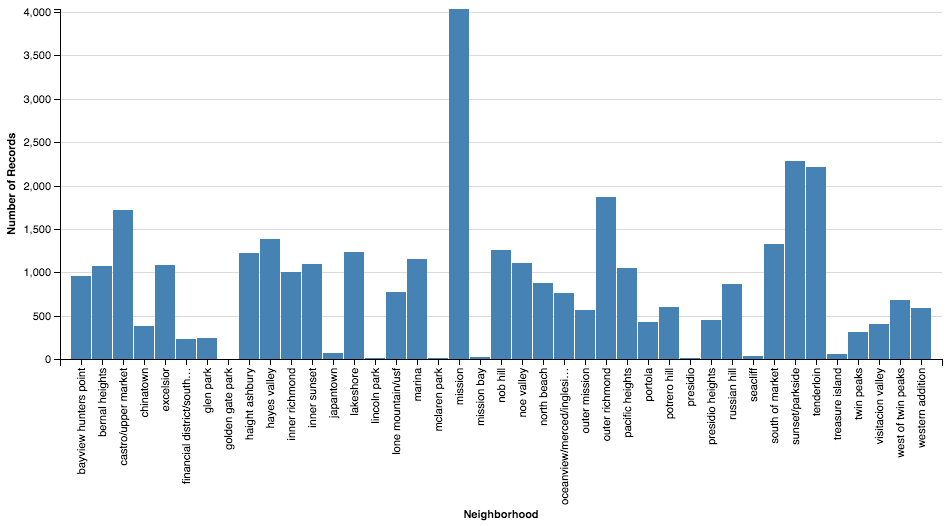

In [8]:
#Create a dataframe for the basic neighborhood data, for EDA.  
evictions_basic = evict[['Address', 'Neighborhood', 'date']]

Chart(evictions_basic).mark_bar().encode(
    X("Neighborhood"),
    Y('count(*)')
)

In this dataset, most neighborhoods have had at least a few hundred evictions over this time period. However, there are fow that have more evictions overall than others. 

A few neighborhoods of interest: 
- mission
- outer richmond
- sunset/parkside
- tenderloin
- castro/uppor market

## Evictions per Year

Let's see how the number of evictions trends over the years. 

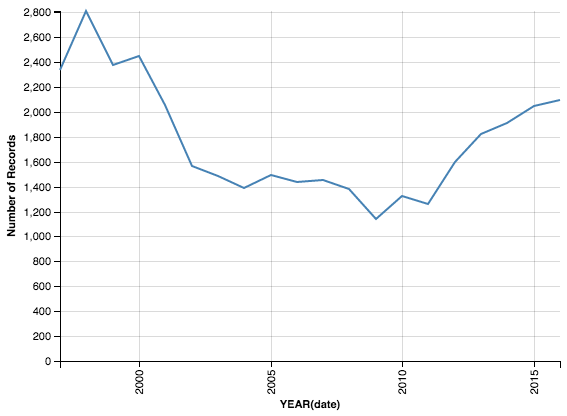

In [6]:
Chart(evictions_basic).mark_line().encode(
    X('date:T', timeUnit='year'),
    Y('count(*)')
)

What does this look like per neighborhood? 

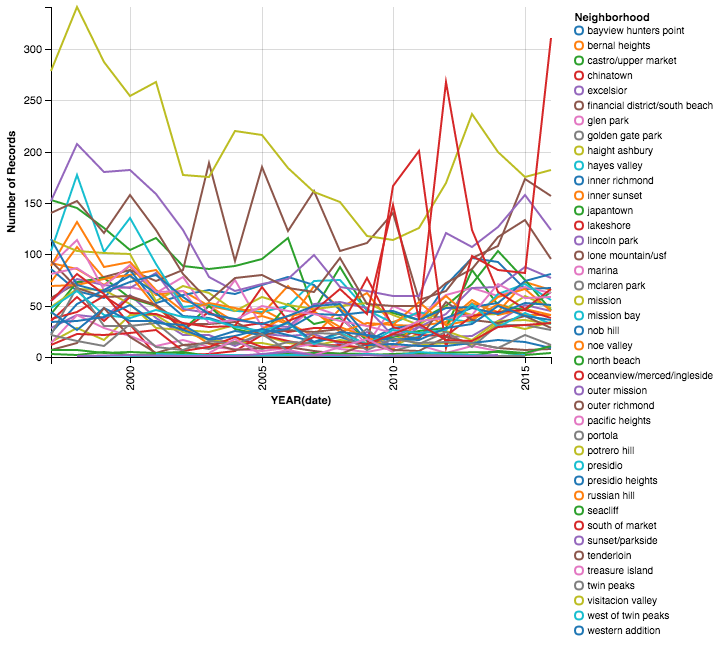

In [7]:
Chart(evict).mark_line().encode(
    X('date:T', timeUnit='year'),
    Y('count(*)'),
    Color('Neighborhood')
)

It's a little hard to see, but let's just look at the five neighborhoods that we pointed out earlier. 

In [7]:
spotlight_neighborhoods = ['mission',
                        'outer richmond',
                        'sunset/parkside',
                        'tenderloin',
                        'castro/upper market'
]
evictions_spotlight = evictions_basic[evictions_basic['Neighborhood'].isin(spotlight_neighborhoods)]

NameError: name 'evictions_basic' is not defined

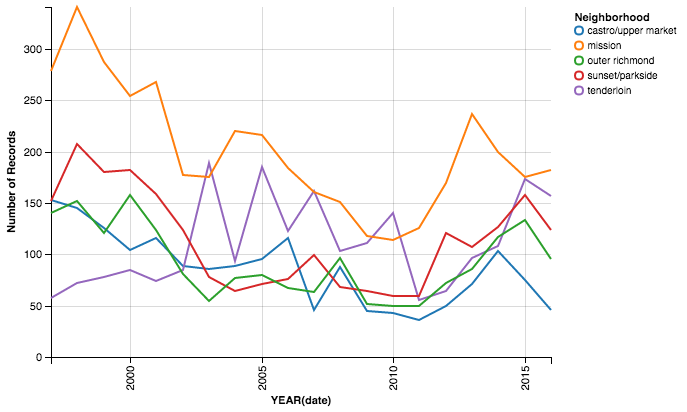

In [9]:
Chart(evictions_spotlight).mark_line().encode(
    X('date:T', timeUnit='year'),
    Y('count(*)'),
    Color('Neighborhood')
)

In all of these neighborhoods, there seems to have been a fall in 2000, and an upswing since 2010. 
Because they all show similar trends, we should be able to use a time series algorithm to predict an overall trend for the San Francisco area. 

## Eviction Reasons

In [20]:
reason_columns = evict[[ 'NonPayment',
 'Breach',
 'Nuisance',
 'IllegalUse',
 'FailuretoSignRenewal',
 'AccessDenial',
 'UnapprovedSubtenant',
 'OwnerMoveIn',
 'Demolition',
 'CapitalImprovement',
 'SubstantialRehab',
 'EllisActWithDrawal',
 'CondoConversion',
 'RoommateSameUnit',
 'OtherCause',
 'LatePayments',
 'LeadRemediation',
 'Development',
 'GoodSamaritanEnds']]

In [21]:
def get_reason(row):
    for c in reason_columns.columns:
        if row[c]==1:
            return c

In [22]:
reasons = evict.apply(get_reason, axis=1)
reasons.head()

0    EllisActWithDrawal
1           OwnerMoveIn
2                Breach
3    EllisActWithDrawal
4    CapitalImprovement
dtype: object

In [25]:
evict['reason'] = reasons;
evict.to_csv('/data/leils/evict_with_reasons.csv')
evict.head()

,Address,NonPayment,Breach,Nuisance,IllegalUse,FailuretoSignRenewal,AccessDenial,UnapprovedSubtenant,OwnerMoveIn,Demolition,...,CondoConversion,RoommateSameUnit,OtherCause,LatePayments,LeadRemediation,Development,GoodSamaritanEnds,Neighborhood,date,reason
0,300 Block Of Park Street,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,bernal heights,2016-06-06,EllisActWithDrawal
1,200 Block Of Seneca Avenue,False,False,False,False,False,False,False,True,False,...,False,False,False,False,False,False,False,outer mission,2016-06-29,OwnerMoveIn
2,200 Block Of Dolores Street,False,True,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,castro/upper market,2016-06-28,Breach
3,1200 Block Of 9th Avenue,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,inner sunset,2016-06-02,EllisActWithDrawal
4,1400 Block Of Larkin Street,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,nob hill,2016-02-28,CapitalImprovement


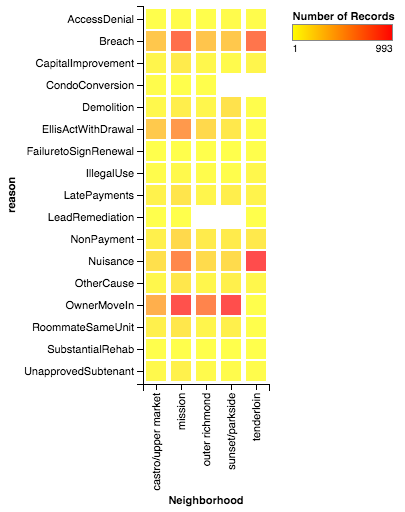

In [9]:
Chart(evict_reasons[evict_reasons.Neighborhood.isin(spotlight_neighborhoods)].dropna()).mark_bar().encode(
    X("Neighborhood"),
    Y('reason'),
    Color('count(*)', scale=Scale(range=['yellow','red']))
)

Here we can see that the most common reason for evictions across the board are Breach, Ellis Act Withdrawal, Nuisance, and Owner Move-in. 
How do these change over time? 

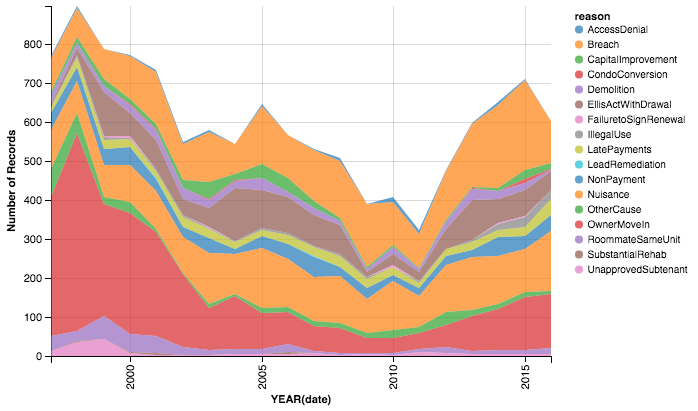

In [10]:
Chart(evict_reasons[evict_reasons.Neighborhood.isin(spotlight_neighborhoods)].dropna()).mark_area().encode(
    X("date:T", timeUnit='year'),
    Y('count(*)'),
    Color('reason')
)

We can see that Breach and Nuisance have ballooned in the last 10 years. However, Owner Move In has shrunk considerably. 

## Police Data
Let's take a look at police incidents, just in the Mission district. Because this dataset is large, we will visualize only the data from the last year of reports (2016)

In [18]:
police['Date'] = pd.to_datetime(police['Date'])

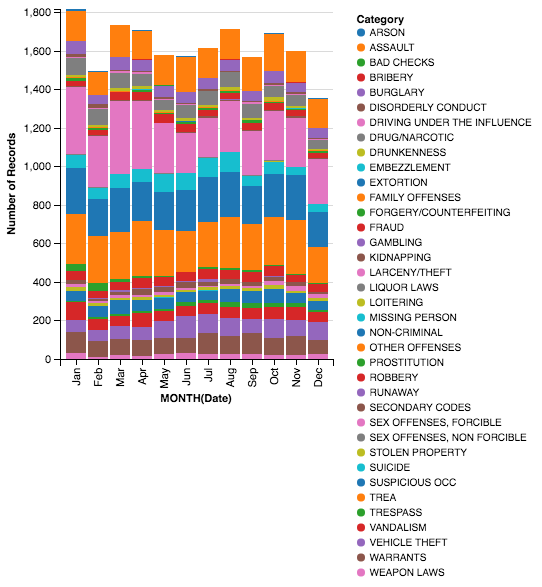

In [99]:
Chart(police[police.Date.dt.year == 2014]).mark_bar().encode(
    X('Date:T', timeUnit='month'),
    Y('count(*)'),
    Color('Category')
)

We can definitely see that there's an upswing in incidents as we enter Fall and Winter. Our highest rate of criminal incidents appears in October, and our lowest appears in February. 

Let's make a dataset that includes the criminal activity and monthly eviction rate for 2010-2016. Can we find a relationship? 

In [90]:
#first we deal with evictions
#Only get years 2010-2016
monthly_mission = evictions_basic[evictions_basic['Neighborhood']=='mission']
monthly_mission['date'] = pd.to_datetime(monthly_mission['date'])
monthly_mission = monthly_mission[monthly_mission['date'].dt.year.isin([2016, 2015, 2014, 2013, 2012, 2011, 2010])]

#Group by month, and make sure we use the 1st of each month
monthly_mission = monthly_mission.set_index('date').groupby(pd.TimeGrouper(freq='M'))['Address'].count()
monthly_mission = monthly_mission.reset_index()
monthly_mission.date = monthly_mission.date.apply(lambda dt: dt.replace(day=1))
monthly_mission = monthly_mission.rename(columns={'Address':'EvictionCount'})

/opt/conda/lib/python3.5/site-packages/ipykernel/__main__.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


In [91]:
monthly_mission.head()

,date,EvictionCount
0,2010-01-01,12
1,2010-02-01,12
2,2010-03-01,7
3,2010-04-01,21
4,2010-05-01,6


In [92]:
#let's do the same with the police data 
monthly_police = police[police.Date.dt.year.isin([2010,2011,2012,2013,2014,2015,2016])]
monthly_police = monthly_police.set_index('Date').groupby(pd.TimeGrouper(freq='M'))['Category'].count()
# monthly_police.reset_index()
# monthly_police.Category.value_counts()
monthly_police = monthly_police.reset_index()
# monthly_mission.date = monthly_mission.date.apply(lambda dt: dt.replace(day=1))
monthly_police.Date = monthly_police.Date.apply(lambda dt: dt.replace(day=1))
monthly_police = monthly_police.rename(columns={'Category':'IncidentCount', 'Date':'date'})
monthly_police.head()


,date,IncidentCount
0,2010-01-01,1601
1,2010-02-01,1407
2,2010-03-01,1478
3,2010-04-01,1413
4,2010-05-01,1676


In [93]:
monthly_mission_total = monthly_mission.merge(monthly_police, left_on='date', right_on='date', how='outer')
monthly_mission_total.head()

,date,EvictionCount,IncidentCount
0,2010-01-01,12,1601
1,2010-02-01,12,1407
2,2010-03-01,7,1478
3,2010-04-01,21,1413
4,2010-05-01,6,1676


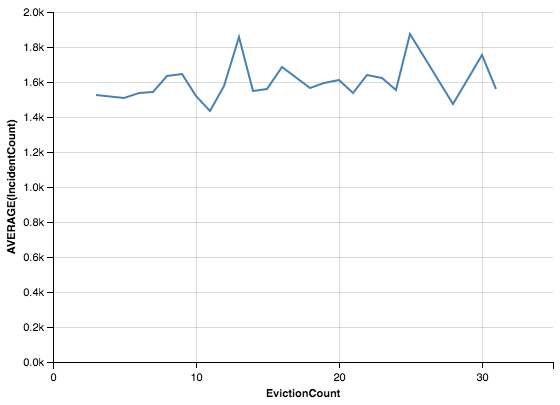

In [97]:
Chart(monthly_mission_total).mark_line().encode(
    X('EvictionCount'),
    Y('average(IncidentCount)')
)